In [2]:
import pandas as pd # data processing
import numpy as np # linear algebra
import os

In [3]:
file_train = 'C:/Users/Mark/Desktop/Cancer_Data/train.csv'

df_train = pd.read_csv(file_train)

df_train.head()

,site_id,patient_id,image_id,laterality,view,age,cancer,biopsy,invasive,BIRADS,implant,density,machine_id,difficult_negative_case
0,2,10006,462822612,L,CC,61.0,0,0,0,NaN,0,NaN,29,False
1,2,10006,1459541791,L,MLO,61.0,0,0,0,NaN,0,NaN,29,False
2,2,10006,1864590858,R,MLO,61.0,0,0,0,NaN,0,NaN,29,False
3,2,10006,1874946579,R,CC,61.0,0,0,0,NaN,0,NaN,29,False
4,2,10011,220375232,L,CC,55.0,0,0,0,0.0,0,NaN,21,True


In [4]:
print(f'Length of file_train dataframe: {len(df_train)}\n')
print(f'Number of NaN values in file_train:\n{df_train.isna().sum()}\n')

Length of file_train dataframe: 54706

Number of NaN values in file_train:
site_id                        0
patient_id                     0
image_id                       0
laterality                     0
view                           0
age                           37
cancer                         0
biopsy                         0
invasive                       0
BIRADS                     28420
implant                        0
density                    25236
machine_id                     0
difficult_negative_case        0
dtype: int64



In [5]:
len(df_train)

54706

In [6]:
df_train.isnull().sum()

site_id                        0
patient_id                     0
image_id                       0
laterality                     0
view                           0
age                           37
cancer                         0
biopsy                         0
invasive                       0
BIRADS                     28420
implant                        0
density                    25236
machine_id                     0
difficult_negative_case        0
dtype: int64

In [7]:
#let's consider one particular patient
patient_id = df_train[df_train.cancer == 1].iloc[0].patient_id

df_one_patient = df_train[df_train.patient_id == patient_id]
df_one_patient

,site_id,patient_id,image_id,laterality,view,age,cancer,biopsy,invasive,BIRADS,implant,density,machine_id,difficult_negative_case
87,1,10130,388811999,L,MLO,71.0,1,1,1,0.0,0,B,49,False
88,1,10130,613462606,L,CC,71.0,1,1,1,0.0,0,B,49,False
89,1,10130,1360338805,L,CC,71.0,1,1,1,0.0,0,B,49,False
90,1,10130,1672636630,L,MLO,71.0,1,1,1,0.0,0,B,49,False
91,1,10130,1013166704,R,CC,71.0,0,0,0,NaN,0,B,49,False
92,1,10130,1165309236,R,CC,71.0,0,0,0,NaN,0,B,49,False
93,1,10130,2110820077,R,MLO,71.0,0,0,0,NaN,0,B,49,False


In [8]:
# Path formatting for images
images_dir = r"C:/Users/Mark/Desktop/train_images/{}/{}.dcm"

train = 'train'
test = 'test'

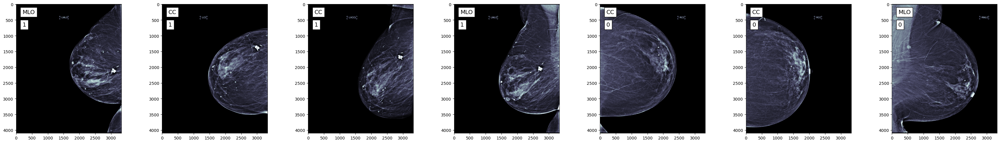

In [9]:
import matplotlib.pyplot as plt
import dicomsdl

# Define the directory structure for your DICOM images
images_dir = r"C:/Users/Mark/Desktop/train_images/{}/{}.dcm"

n_rows = len(df_one_patient)

plt.figure(figsize=(5 * n_rows, 5))
for i in range(n_rows):
    row = df_one_patient.iloc[i]
    
    # Construct the path to the DICOM file using patient_id and image_id
    dicom_path = images_dir.format(row.patient_id, row.image_id)
    
    # Open the DICOM file and get the pixel data
    img_arr = dicomsdl.open(dicom_path).pixelData()
    
    # Create a subplot for each image
    plt.subplot(1, n_rows, i + 1)
    
    # Display the DICOM image with a bone colormap
    plt.imshow(img_arr, cmap=plt.cm.bone)
    
    # Add text annotations for 'view' and 'cancer' information
    plt.text(200, 300, row['view'], fontsize=14, bbox={'facecolor': 'white', 'pad': 5})
    plt.text(200, 700, str(row['cancer']), fontsize=14, bbox={'facecolor': 'white', 'pad': 5})
    
    # axis can be turn on or off for a cleaner display
    plt.axis('on')

# Adjust the layout to prevent overlap
plt.tight_layout()

# Show the plot with the DICOM images
plt.show()


<Axes: xlabel='laterality', ylabel='count'>

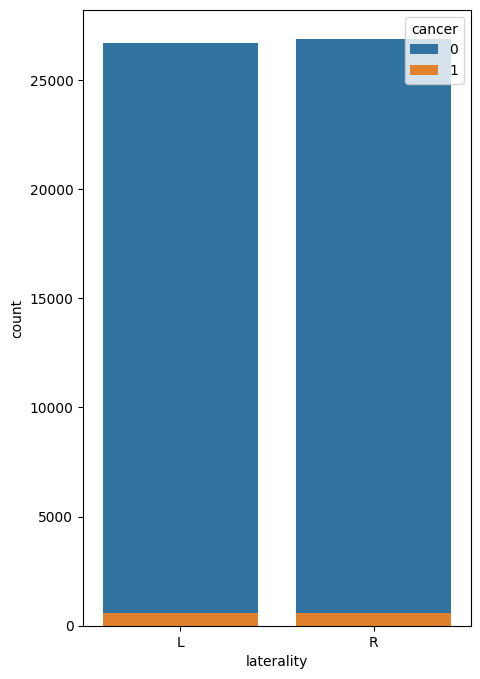

In [10]:
import seaborn as sns

plt.figure(figsize=(5, 8))
sns.countplot(data = df_train, x="laterality", hue="cancer", dodge = False)

<Axes: xlabel='view', ylabel='count'>

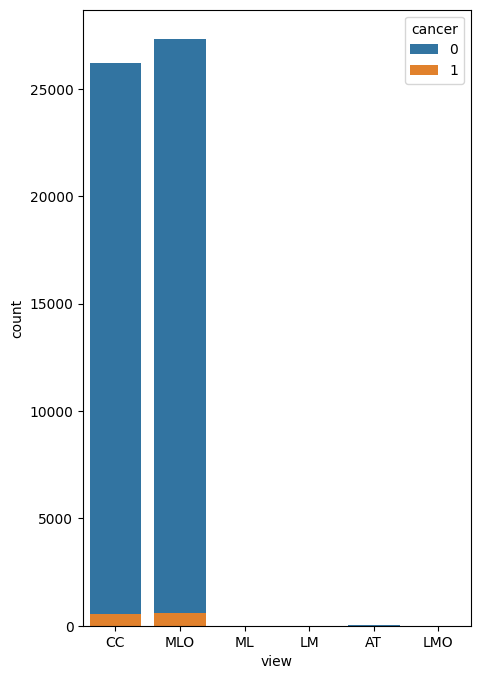

In [11]:
plt.figure(figsize=(5, 8))

sns.countplot(data = df_train, x="view", hue="cancer", dodge = False)

In [12]:
df_train.view.value_counts()

view
MLO    27903
CC     26765
AT        19
LM        10
ML         8
LMO        1
Name: count, dtype: int64

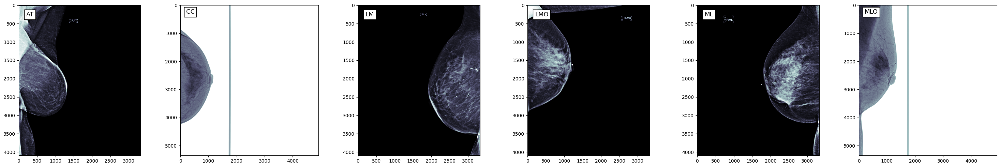

In [13]:
import matplotlib.pyplot as plt
import dicomsdl

images_dir = r"C:/Users/Mark/Desktop/train_images/{}/{}.dcm"

# List of unique views
LIST_OF_VIEWS = sorted(list(df_train.view.unique()))

plt.figure(figsize=(5 * len(LIST_OF_VIEWS), 5))

for i, v in enumerate(LIST_OF_VIEWS, start=1):
    # Create a subplot for each view
    plt.subplot(1, len(LIST_OF_VIEWS), i)
    
    # Get the row corresponding to the current view
    row = df_train.loc[df_train['view'] == v].iloc[0]
    
    # Construct the correct path using patient_id and image_id
    dicom_path = images_dir.format(row.patient_id, row.image_id)
    
    # Open the DICOM file and get the pixel data
    img_arr = dicomsdl.open(dicom_path).pixelData()
    
    # Display the image using bone colormap
    plt.imshow(img_arr, cmap=plt.cm.bone)
    
    # Add a text label for the view
    plt.text(200, 300, v, fontsize=13, bbox={'facecolor': 'white'})
    
    # Turn 0n or off the axis
    plt.axis('on')


plt.tight_layout()
plt.show()


In [15]:
# split dataset in two groups depending on view (to investigate them a bit more):
# 1. MLO and CC - major group
# 2. all other views - minor group

major_group = ['CC', 'MLO']

df_train_major_group = df_train[df_train.view.isin(major_group)]
df_train_minor_group = df_train[~df_train.view.isin(major_group)]

In [16]:
df_train_minor_group.cancer.value_counts()

cancer
0    36
1     2
Name: count, dtype: int64

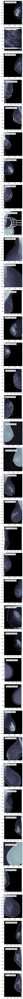

In [17]:

images_dir = r"C:/Users/Mark/Desktop/train_images/{}/{}.dcm"

plt.figure(figsize=(4, 4 * len(df_train_minor_group)))

for i, row in enumerate(df_train_minor_group.itertuples(index=False), start=1):
    plt.subplot(len(df_train_minor_group), 1, i)
    
    # Construct the correct file path
    dicom_path = images_dir.format(row.patient_id, row.image_id)
    
    # Load the DICOM image using dicomsdl
    img = dicomsdl.open(dicom_path)
    img_arr = img.pixelData()
    
    # Standardize all scans
    img_arr = (img_arr - img_arr.min()) / (img_arr.max() - img_arr.min())
    
    # Check the photometric interpretation
    if img.PhotometricInterpretation == "MONOCHROME1":
        img_arr = 1 - img_arr
    
    # Display the image
    plt.imshow(img_arr, cmap=plt.cm.bone)
    plt.text(200, 300, f'{row.patient_id} {row.image_id}', fontsize=13, bbox={'facecolor': 'white'})
    
plt.tight_layout()
plt.show()


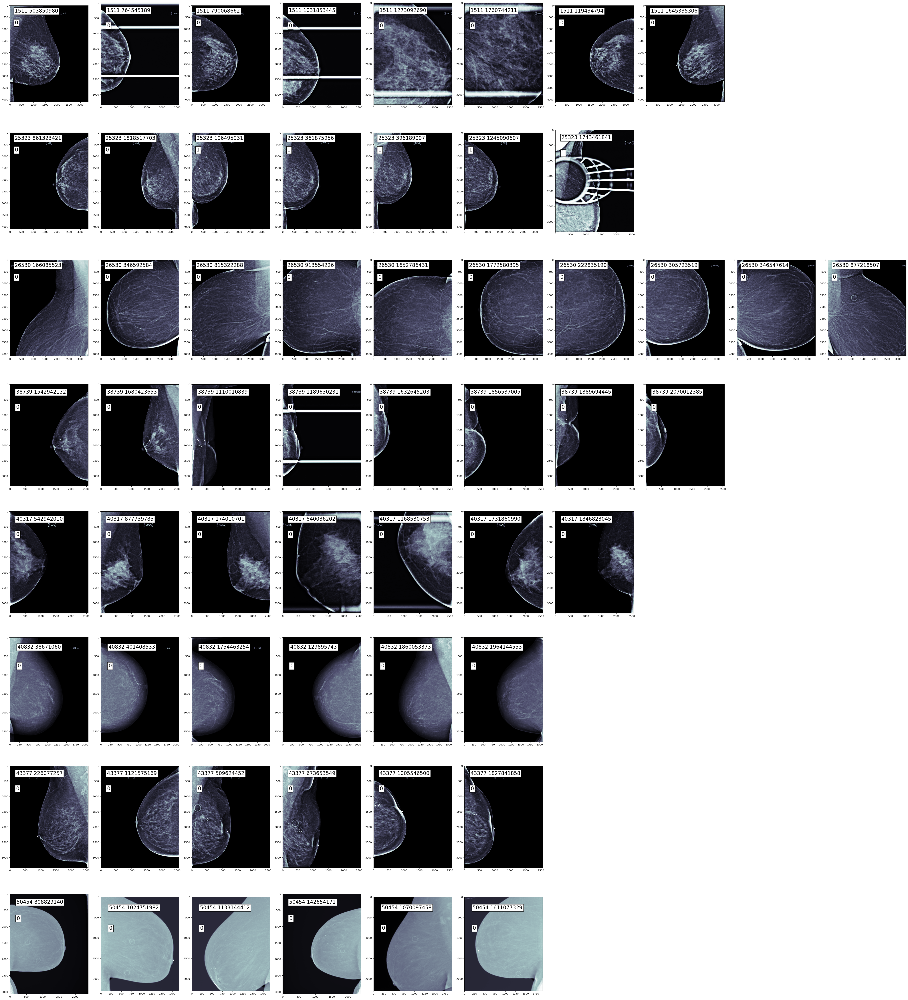

In [18]:
# Here i want to investigate patients which scans look weird

images_dir = r"C:/Users/Mark/Desktop/train_images/{}/{}.dcm"

def display_scans_by_patient_id(ids):
    plt.figure(figsize=(10 * 5, len(ids) * 7))  # Increase figure size based on rows and columns
    for i, patient_id in enumerate(ids):
        df = df_train[df_train.patient_id == patient_id].iloc[:10]
        
        for j, row in enumerate(df.itertuples(index=False)):
            plt.subplot(len(ids), 10, i * 10 + j + 1)
            
            # Construct the DICOM path
            dicom_path = images_dir.format(row.patient_id, row.image_id)
            
            # Open the DICOM image
            img = dicomsdl.open(dicom_path)
            img_arr = img.pixelData()
            
            # Standardize the pixel values
            img_arr = (img_arr - img_arr.min()) / (img_arr.max() - img_arr.min())
            
            # Invert image if MONOCHROME1
            if img.PhotometricInterpretation == "MONOCHROME1":
                img_arr = 1 - img_arr
            
            # Display the image
            plt.imshow(img_arr, cmap=plt.cm.bone)
            
            # Add text for patient ID and cancer status
            plt.text(200, 300, f'{row.patient_id} {row.image_id}', fontsize = 20, bbox={'facecolor': 'white'})
            plt.text(200, 800, f'{row.cancer}', fontsize = 20, bbox={'facecolor': 'white'})

          
    plt.tight_layout()
    plt.show()

# Example patient IDs to display
patient_ids = [1511, 25323, 26530, 38739, 40317, 40832, 43377, 50454]
display_scans_by_patient_id(patient_ids)


In [19]:
bad_ids = patient_ids.copy()

In [20]:
# I'm going to exclude patiens which have bad scans and don't have cancer (because we have a lot non-cancer scans)

# all above patients have no cancer except 25323 patient
# for this specific one I'm going to remove only 'bad' scans
specific_patient = 25_323
bad_ids.remove(specific_patient)

In [21]:
bad_ids.append(27_770)

Trying to open: C:/Users/Mark/Desktop/train_images/56713/238470103.dcm
Trying to open: C:/Users/Mark/Desktop/train_images/64908/1880660195.dcm
Trying to open: C:/Users/Mark/Desktop/train_images/24656/1539009830.dcm
Trying to open: C:/Users/Mark/Desktop/train_images/60653/101263956.dcm
Trying to open: C:/Users/Mark/Desktop/train_images/54930/1314799188.dcm
Trying to open: C:/Users/Mark/Desktop/train_images/19003/4493744.dcm
Trying to open: C:/Users/Mark/Desktop/train_images/50741/970290638.dcm
Trying to open: C:/Users/Mark/Desktop/train_images/46106/402243731.dcm
Trying to open: C:/Users/Mark/Desktop/train_images/65222/111055050.dcm
Trying to open: C:/Users/Mark/Desktop/train_images/31046/1184643445.dcm
Trying to open: C:/Users/Mark/Desktop/train_images/1336/338330540.dcm
Trying to open: C:/Users/Mark/Desktop/train_images/23101/22058316.dcm
Trying to open: C:/Users/Mark/Desktop/train_images/65198/712545807.dcm
Trying to open: C:/Users/Mark/Desktop/train_images/44121/546226529.dcm
Trying

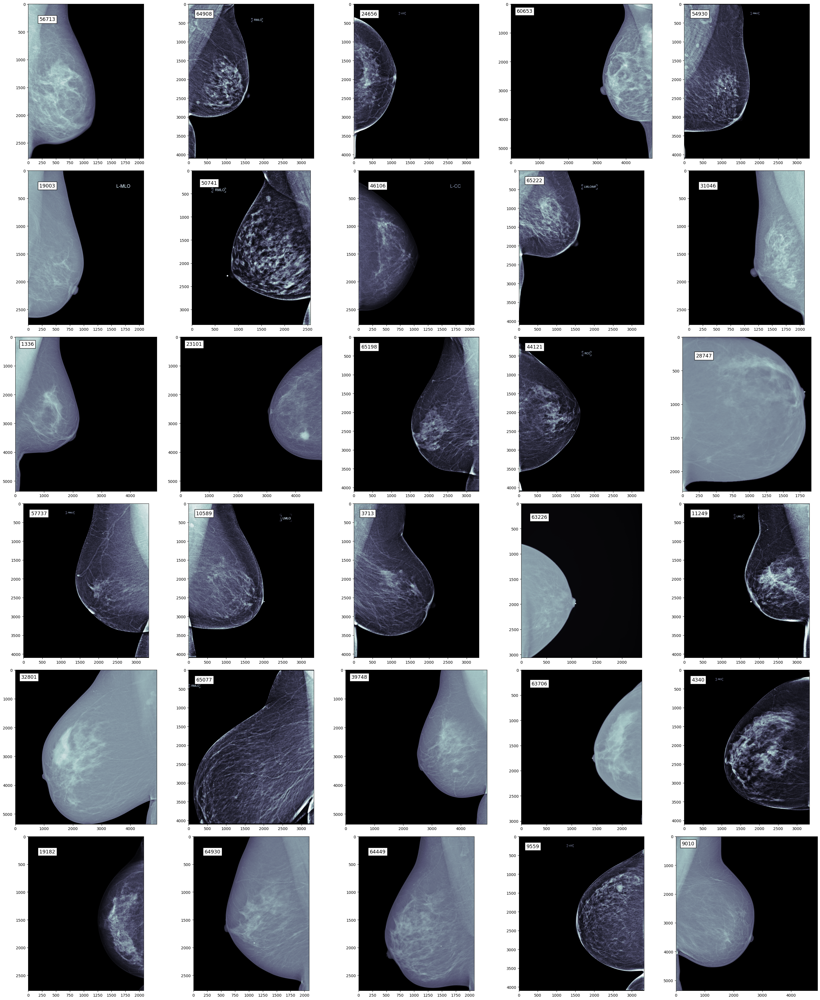

In [22]:
# let's check few scans which was marked as 'having cancer' from major view group
# maybe we'll find something weird

images_dir = r"C:/Users/Mark/Desktop/train_images/{}/{}.dcm"

df = df_train_major_group[~(df_train_major_group.patient_id.isin(patient_ids)) & (df_train_major_group.cancer == 1)]
df = df.groupby(['patient_id'])['image_id'].apply(lambda x: x.iloc[0]).to_frame().reset_index().sample(n=30, random_state=42)

plt.figure(figsize=(30, 36))  # Adjust figure size to fit the images

for i, row in enumerate(df.itertuples(index=False), start=1):
    plt.subplot(6, 5, i)  # Adjust the grid size to match your needs

    # Construct the DICOM file path correctly
    dicom_path = images_dir.format(row.patient_id, row.image_id)
    print(f"Trying to open: {dicom_path}")  # Debugging line

    try:
        # Open the DICOM image
        img = dicomsdl.open(dicom_path)
        img_arr = img.pixelData()

        # Standardize the pixel values
        img_arr = (img_arr - img_arr.min()) / (img_arr.max() - img_arr.min())

        # Invert the image if needed (MONOCHROME1)
        if img.PhotometricInterpretation == "MONOCHROME1":
            img_arr = 1 - img_arr

        # Display the image
        plt.imshow(img_arr, cmap=plt.cm.bone)

        # Add text for patient ID status
        plt.text(200, 300, f'{row.patient_id}', fontsize = 13, bbox={'facecolor': 'white'})

    except Exception as e:
        print(f"Error opening DICOM for {row.patient_id} - {row.image_id}: {e}")

plt.tight_layout()
plt.show()


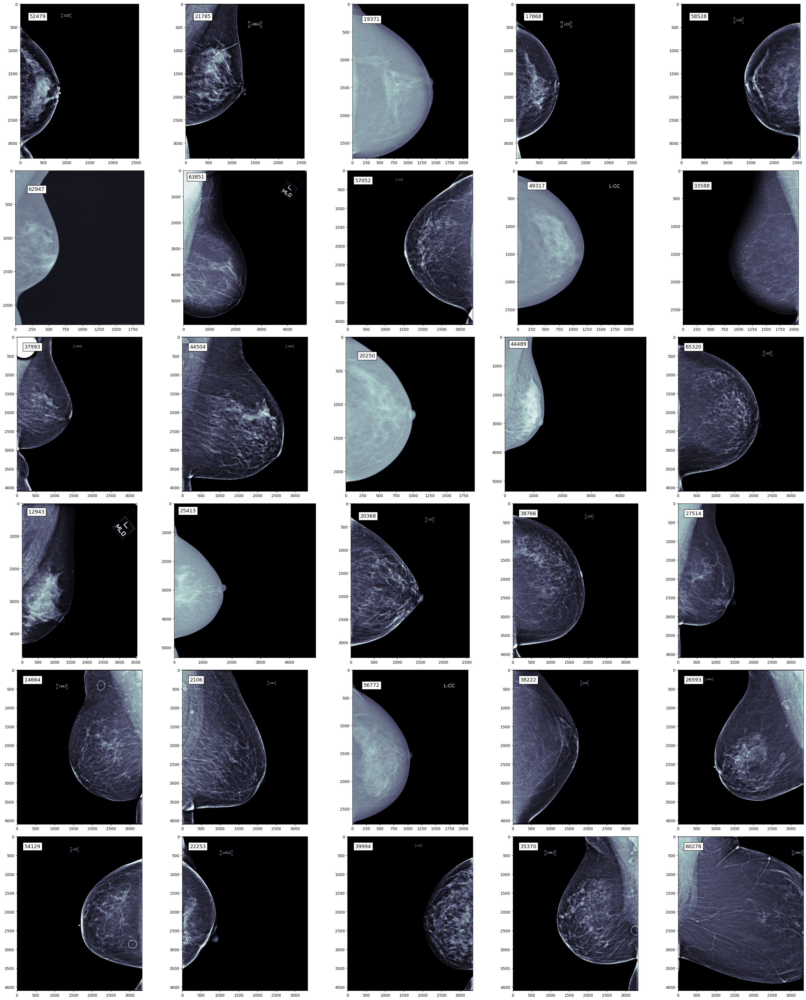

In [23]:
# and without cancer

images_dir = r"C:/Users/Mark/Desktop/train_images/{}/{}.dcm"

df = df_train_major_group[~(df_train_major_group.patient_id.isin(patient_ids)) & (df_train_major_group.cancer == 0)]
df = df.groupby(['patient_id'])['image_id'].apply(lambda x : x.iloc[0]).to_frame().reset_index().sample(n = 30, random_state = 42)

plt.figure(figsize=(6 * 5, 6 * 6)) # 6x5

for i, row in enumerate(df.itertuples(), start = 1):
            plt.subplot(6, 5, i)

            # Construct the DICOM file path correctly
            dicom_path = images_dir.format(row.patient_id, row.image_id)

            try:
                # Open the DICOM image
                img = dicomsdl.open(dicom_path)
                img_arr = img.pixelData()
    
                # standardize all scans
                img_arr = (img_arr - img_arr.min()) / (img_arr.max() - img_arr.min())
                if img.PhotometricInterpretation == "MONOCHROME1":
                    img_arr = 1 - img_arr
        
                plt.imshow(img_arr, cmap = plt.cm.bone)
                plt.text(200, 300, f'{row.patient_id}', fontsize = 13, bbox={'facecolor': 'white'})

            except Exception as e:
                print(f"Error opening DICOM for {row.patient_id} - {row.image_id}: {e}")
    
plt.tight_layout()
plt.show()

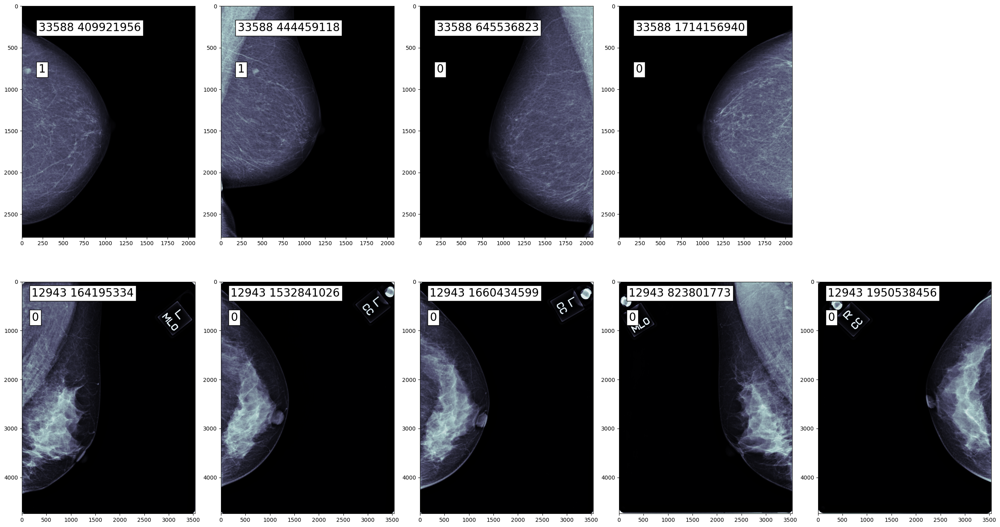

In [24]:
# again investigate patients having 'weird' scans

images_dir = r"C:/Users/Mark/Desktop/train_images/{}/{}.dcm"

patient_ids = [33588, 12943]
display_scans_by_patient_id(patient_ids)

In [25]:
# patient_ids - list of patients having 'bad' scans
df_train = df_train[~df_train.patient_id.isin(bad_ids)]

index_to_remove = df_train.loc[(df_train.patient_id == specific_patient) & ( df_train.image_id == 1743461841), :].index
df_train.drop(index = index_to_remove, inplace = True)

In [26]:
cancer_count = df_train.cancer.value_counts()
cancer_count

cancer
0    53489
1     1157
Name: count, dtype: int64

In [27]:
min_cancer_count = cancer_count.min()

df_train = pd.concat([df_train[df_train.cancer == i].sample(n=min_cancer_count) 
                      for i, _ in cancer_count.items()])

len(df_train)


2314

In [28]:
from sklearn.model_selection import train_test_split

X_train, X_val = train_test_split(df_train, test_size = 0.2, random_state = 42)
len(X_train), len(X_val)

(1851, 463)

In [29]:
import tensorflow as tf

In [30]:
from enum import Enum, auto

class Mode(Enum):
    TRAIN = auto()
    TEST = auto()

In [31]:
import numpy as np
import tensorflow as tf
import dicomsdl
from enum import Enum

# Define constants
img_height = 300
img_width = 250
img_shape = (img_height, img_width, 1)


class ImageDataGen(tf.keras.utils.Sequence):
    
    def __init__(self, df, batch_size, mode=Mode.TRAIN):
        self.df = df
        self.batch_size = batch_size
        self.mode = mode
        self.mode_str = "train" if mode == Mode.TRAIN else "test"
        self.len = len(df)
        
    def __getitem__(self, index):
        start, end = index * self.batch_size, (index + 1) * self.batch_size
        
        X = np.zeros((self.batch_size, ) + img_shape)
        y = np.zeros((self.batch_size, 1))
        
        for i, pos in enumerate(range(start, end)):
            if pos >= self.len:
                break
            
            row = self.df.iloc[pos]
            patient_id = row.patient_id
            img_id = row.image_id
            file_name = images_dir.format(self.mode_str, patient_id, img_id)
            
            try:
                # Open the DICOM image
                img = dicomsdl.open(file_name)
                img_arr = img.pixelData()
                
                # Standardize pixel values
                img_arr = (img_arr - img_arr.min()) / (img_arr.max() - img_arr.min())
                
                # Invert the image if needed (MONOCHROME1)
                if img.PhotometricInterpretation == "MONOCHROME1":
                    img_arr = 1 - img_arr

                # Expand dimensions and resize
                img_arr = np.expand_dims(img_arr, axis=-1)
                img_arr = tf.image.resize(img_arr, img_shape[:-1], method='nearest').numpy()
                X[i, ...] = img_arr
                
            except Exception as e:
                print(f"Error loading {file_name}: {e}")
                continue
            
            # Assign labels if in training mode
            if self.mode == Mode.TRAIN:
                y[i] = row.cancer
                
        return (X, y) if self.mode == Mode.TRAIN else X
    
    def __len__(self):
        return self.len // self.batch_size + bool(self.len % self.batch_size)


In [32]:
train_gen = ImageDataGen(X_train, 50)
val_gen = ImageDataGen(X_val, 50)

In [33]:
import tensorflow.keras as K

from tensorflow.keras import Sequential
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import (Conv2D, 
                                     MaxPooling2D, 
                                     BatchNormalization, 
                                     Dense, 
                                     Dropout,
                                     GlobalMaxPooling2D)

In [34]:
from tensorflow.keras import Sequential, Input
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dropout, Dense, GlobalMaxPooling2D, BatchNormalization

# Define input shape explicitly
img_shape = (300, 250, 1)

# Build the model
model = Sequential()

# Use Input layer as the first layer
model.add(Input(shape=img_shape))

# Block 1
model.add(Conv2D(32, (5, 5), activation="relu"))
model.add(Conv2D(64, (5, 5), activation="relu"))
model.add(Conv2D(64, (5, 5), activation="relu"))
model.add(MaxPooling2D())
model.add(Dropout(0.3))

# Block 2
model.add(Conv2D(64, (5, 5), activation="relu"))
model.add(Conv2D(128, (5, 5), activation="relu"))
model.add(Conv2D(128, (5, 5), activation="relu"))
model.add(MaxPooling2D())
model.add(Dropout(0.3))

# Block 3
model.add(Conv2D(128, (5, 5), activation="relu"))
model.add(Conv2D(256, (5, 5), activation="relu"))
model.add(Conv2D(256, (5, 5), activation="relu"))
model.add(GlobalMaxPooling2D())
model.add(Dropout(0.3))

# Dense layers
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.3))
model.add(Dense(1, activation='sigmoid'))  # Binary classification

# Compile the model
recall_thresholds = [0.4, 0.5, 0.6, 0.8]
model.compile(optimizer=Adam(learning_rate=5e-5),
              loss='binary_crossentropy',
              metrics=[tf.keras.metrics.BinaryAccuracy(threshold=0.5),
                       tf.keras.metrics.Recall(thresholds=recall_thresholds),
                       tf.keras.metrics.Precision(thresholds=recall_thresholds)])

# Print summary
model.summary()


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 296, 246, 32)   │           832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 292, 242, 64)   │        51,264 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 288, 238, 64)   │       102,464 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 144, 119, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 144, 119, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 140, 115, 64)   │       102,464 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 136, 111, 128)  │       204,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 132, 107, 128)  │       409,728 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 66, 53, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 66, 53, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 62, 49, 128)    │       409,728 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 58, 45, 256)    │       819,456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_8 (Conv2D)               │ (None, 54, 41, 256)    │     1,638,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_max_pooling2d            │ (None, 256)            │             0 │
│ (GlobalMaxPooling2D)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 64)             │        16,448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,756,033 (14.33 MB)

 Trainable params: 3,756,033 (14.33 MB)

 Non-trainable params: 0 (0.00 B)

In [35]:
# callbacks
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

early_stop = EarlyStopping(patience = 5, restore_best_weights = True, verbose = 1) # val_loss
reduce_lr = ReduceLROnPlateau(factor = 0.1, patience = 2, mode = 'min', verbose = 1) # val_loss 

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, DepthwiseConv2D, Flatten, Dense
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras import mixed_precision

# Enable mixed precision and XLA for faster computation
policy = mixed_precision.Policy('mixed_float16')
mixed_precision.set_global_policy(policy)
tf.config.optimizer.set_jit(True)  # Enable XLA (Accelerated Linear Algebra)

# Define your batch size and data dimensions
batch_size = 256  # Increased batch size for faster training
height = 128
width = 128
channels = 3
num_classes = 10

# Generator functions (unchanged)
def train_gen():
    while True:
        input_batch = tf.random.normal((batch_size, height, width, channels))
        label_batch = tf.random.uniform((batch_size,), maxval=num_classes, dtype=tf.int32)
        yield input_batch, label_batch

def val_gen():
    while True:
        input_batch = tf.random.normal((batch_size, height, width, channels))
        label_batch = tf.random.uniform((batch_size,), maxval=num_classes, dtype=tf.int32)
        yield input_batch, label_batch

# Preprocess function to normalize the input data
def preprocess(input_batch, label_batch):
    input_batch = input_batch / 255.0
    return input_batch, label_batch

# Create datasets from the generators
train_dataset = tf.data.Dataset.from_generator(
    train_gen, 
    output_signature=(tf.TensorSpec(shape=(batch_size, height, width, channels), dtype=tf.float32),
                      tf.TensorSpec(shape=(batch_size,), dtype=tf.int32))
).map(preprocess, num_parallel_calls=tf.data.AUTOTUNE).prefetch(buffer_size=tf.data.AUTOTUNE)

val_dataset = tf.data.Dataset.from_generator(
    val_gen, 
    output_signature=(tf.TensorSpec(shape=(batch_size, height, width, channels), dtype=tf.float32),
                      tf.TensorSpec(shape=(batch_size,), dtype=tf.int32))
).map(preprocess, num_parallel_calls=tf.data.AUTOTUNE).prefetch(buffer_size=tf.data.AUTOTUNE)

# Create and compile your model with DepthwiseConv2D for speed
model = Sequential([
    Input(shape=(height, width, channels)),
    DepthwiseConv2D(kernel_size=(3, 3), activation='relu'),  # Efficient layer
    Flatten(),
    Dense(128, activation='relu'),
    Dense(num_classes, activation='softmax')
])

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Define your callbacks
early_stop = EarlyStopping(patience=5, restore_best_weights=True, verbose=1)  # Stop if no improvement
reduce_lr = ReduceLROnPlateau(factor=0.1, patience=2, mode='min', verbose=1)  # Reduce LR if val_loss doesn't improve

# Train the model with callbacks
history = model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=15,
    verbose=1,
    callbacks=[early_stop, reduce_lr]  # Include the callbacks here
)

In [ ]:
history = model.fit(train_gen,
                    validation_data=val_gen,
                    epochs=15,
                    verbose=1,
                    workers=8,  # Number of worker threads for data loading
                    use_multiprocessing=True,  # Enables multiprocessing with workers
                    callbacks=[reduce_lr])  # Custom callback